# 🔍 Clustering MIMIC IV
**Fecha:** 11 de abril de 2025  
**Autor:** Maria Bernarda Salazar Sánchez

Este notebook representa el primer intento por explorar agrupación presentes en la base de datos **MIMIC IV**. El objetivo principal es aplicar técnicas de **clustering no supervisado** para identificar patrones, duplicados potenciales o variantes de nombres que puedan ayudar en la consolidación de entidades o la mejora de calidad de datos.

### 🧩 Objetivos:
- Cargar y explorar los datos.
- Preprocesar los características (normalización, limpieza, tokenización si aplica).
- Aplicar una técnica de clustering (K-means, AgglomerativeClustering)
- Visualizar y analizar los resultados.

> 🚧 Este es un primer experimento. El enfoque, técnicas y métricas pueden cambiar en futuras versiones.

## Importar librerías

In [1]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.decomposition import TruncatedSVD
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.preprocessing import LabelEncoder
import os
from sklearn.utils import resample
import itertools
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Cargar datos
Se importa el dataset de MIMIC IV.

In [2]:
# Cargar la base de datos
df = pd.read_csv("Base de datos/BD_ICD9_ORIGINAL_Preprocesada.csv")

# Guardar la columna 'drg_code', es la etiqueta de salida
codigo_grd = df["drg_code"].copy()

# Eliminar 'drg_code' del dataframe para no incluirla en los análisis
df = df.drop(columns=["drg_code","subject_id","drg_type","language"])
print(df.columns)
#print(df.head())
#print(codigo_grd.head())

Index(['hadm_id', 'admission_type', 'admit_provider_id', 'admission_location',
       'discharge_location', 'insurance', 'marital_status', 'race', 'gender',
       'anchor_age', 'description', 'drg_severity', 'drg_mortality', 'dx1',
       'dx2', 'dx3', 'dx4', 'dx5', 'dx6', 'p1', 'cantidad de procedimientos',
       'cantidad de diagnosticos'],
      dtype='object')


In [3]:
new_column_names = {
    'cantidad de procedimientos': 'proc_count',
    'cantidad de diagnosticos': 'dx_count',
}

# Renombrar las columnas del DataFrame
df.rename(columns=new_column_names, inplace=True)

# Verifica los cambios
print(df.head())

    hadm_id admission_type admit_provider_id      admission_location  \
0  22595853         URGENT            P874LG  TRANSFER FROM HOSPITAL   
1  22841357       EW EMER.            P09Q6Y          EMERGENCY ROOM   
2  25742920       EW EMER.            P60CC5          EMERGENCY ROOM   
3  20032235       EW EMER.            P54631          EMERGENCY ROOM   
4  21086876   DIRECT EMER.            P86FCY         CLINIC REFERRAL   

  discharge_location insurance marital_status   race gender  anchor_age  ...  \
0               HOME     Other        WIDOWED  WHITE      F          52  ...   
1               HOME  Medicaid        WIDOWED  WHITE      F          52  ...   
2            HOSPICE  Medicaid        WIDOWED  WHITE      F          52  ...   
3               HOME     Other         SINGLE  WHITE      F          32  ...   
4               HOME     Other         SINGLE  WHITE      F          32  ...   

  drg_mortality    dx1    dx2    dx3    dx4   dx5    dx6      p1 proc_count  \
0      

## **Definición de funciones**

In [4]:
# Identificar tipos de variables
def identify_variable_types(df):
    continuous_vars = df.select_dtypes(include=['float32', 'float64', 'int32', 'int64']).columns.tolist()
    discrete_vars = df.select_dtypes(include=['object', 'category', 'bool']).columns.tolist()
    return continuous_vars, discrete_vars

# Preprocesamiento optimizado
def preprocess_data(df, continuous_vars, discrete_vars):
    ct = ColumnTransformer([
        ('scale', StandardScaler(), continuous_vars),
        ('onehot', OneHotEncoder(handle_unknown='ignore', sparse=True), discrete_vars)
    ], sparse_threshold=0.3)  # solo devuelve matriz dispersa si gran parte es 0

    return ct.fit_transform(df)  # evita conversión a denso si no es necesario

# Determinar número óptimo de clústeres (Silhouette y SSE solamente)
def optimal_clusters(data, max_k=10):
    silhouette_scores = []
    sse = []
    ch_scores = []
    db_scores = []

    for k in range(2, max_k + 1):
        kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
        labels = kmeans.fit_predict(data)

        # Convertir a denso solo si es necesario (para métricas)
        dense_data = data.toarray() if hasattr(data, 'toarray') else data

        silhouette_scores.append(silhouette_score(dense_data, labels, sample_size=1000))
        sse.append(kmeans.inertia_)
        ch_scores.append(calinski_harabasz_score(dense_data, labels))
        db_scores.append(davies_bouldin_score(dense_data, labels))

    # Gráficos
    plt.figure(figsize=(18, 6))

    # Silhouette
    plt.subplot(2, 2, 1)
    plt.plot(range(2, max_k + 1), silhouette_scores, marker='o')
    plt.title("Silhouette Score")
    plt.xlabel("Número de Clústeres")
    plt.ylabel("Silhouette")

    # SSE
    plt.subplot(2, 2, 2)
    sse_scaled = MinMaxScaler().fit_transform(np.array(sse).reshape(-1, 1)).flatten()
    plt.plot(range(2, max_k + 1), sse_scaled, marker='o')
    plt.title("Método del Codo")
    plt.xlabel("Número de Clústeres")
    plt.ylabel("SSE Normalizado")

    # Calinski-Harabasz
    plt.subplot(2, 2, 3)
    plt.plot(range(2, max_k + 1), ch_scores, marker='o', color='green')
    plt.title("Índice Calinski-Harabasz")
    plt.xlabel("Número de Clústeres")
    plt.ylabel("CH Score")

    # Davies-Bouldin
    plt.subplot(2, 2, 4)
    plt.plot(range(2, max_k + 1), db_scores, marker='o', color='red')
    plt.title("Índice Davies-Bouldin")
    plt.xlabel("Número de Clústeres")
    plt.ylabel("DB Score")

    plt.tight_layout()
    plt.show()

    optimal_k = np.argmax(silhouette_scores) + 2
    #print(f"Número óptimo de clústeres según Silhouette Score: {optimal_k}")

    return optimal_k

# Aplicar clustering 
def apply_clustering(data, n_clusters, n_components):
    """
    Aplica clustering a todos los datos con reducción de dimensionalidad.
    Asume que 'data' puede ser una matriz dispersa o densa.
    """
    print(f"📦 Datos recibidos: {data.shape[0]:,} muestras y {data.shape[1]:,} características")

    # Reducción de dimensionalidad (TruncatedSVD es ideal para sparse matrices como TF-IDF)
    svd = TruncatedSVD(n_components=n_components, random_state=42)
    reduced_data = svd.fit_transform(data)

    # Convertir a denso si hace falta
    dense_data = reduced_data.toarray() if hasattr(reduced_data, "toarray") else reduced_data

    results = {}

    # KMeans
    kmeans_labels = KMeans(n_clusters=n_clusters, random_state=42).fit_predict(dense_data)
    results['KMeans'] = kmeans_labels
    print(f"KMeans - Clústeres encontrados: {len(set(kmeans_labels))}")

    # MiniBatchKMeans
    mbk_labels = MiniBatchKMeans(n_clusters=n_clusters, random_state=42).fit_predict(dense_data)
    results['MiniBatchKMeans'] = mbk_labels
    print(f"MiniBatchKMeans - Clústeres encontrados: {len(set(mbk_labels))}")

    return results


# Visualización simple de agrupaciones
def compare_clusters(df, num_features, clustering_results):
    save_path = "./figuras/"
    os.makedirs(save_path, exist_ok=True)
    
    sns.set(style="whitegrid", font_scale=1.0)
    sns.set_context("talk", rc={
        "axes.labelsize": 10, "axes.titlesize": 10, 
        "xtick.labelsize": 9, "ytick.labelsize": 9
    })

    top_columns = df.var(numeric_only=True).nlargest(num_features).index.tolist()
    print(f"\n🔍 Variables seleccionadas: {', '.join(top_columns)}")

    for method, labels in clustering_results.items():
        if len(labels) != len(df):
            print(f"\n⚠️ Clustering '{method}' tiene {len(labels)} etiquetas, pero el DataFrame tiene {len(df)} filas.")
            continue

        df_temp = df.copy()
        df_temp['Cluster'] = labels

        pairs = list(itertools.combinations(top_columns, 2))
        n_cols = 3
        n_rows = (len(pairs) + n_cols - 1) // n_cols

        fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 4 * n_rows))
        axes = axes.flatten()

        for idx, (x_var, y_var) in enumerate(pairs):
            ax = axes[idx]
            show_legend = (idx == len(pairs) - 1)  # Solo en el último subplot
            scatter = sns.scatterplot(
                data=df_temp,
                x=x_var,
                y=y_var,
                hue='Cluster',
                palette='tab10',
                s=60,
                edgecolor='black',
                ax=ax,
                legend=show_legend
            )
            ax.set_xlabel(x_var)
            ax.set_ylabel(y_var)

            x_margin = (df_temp[x_var].max() - df_temp[x_var].min()) * 0.05
            y_margin = (df_temp[y_var].max() - df_temp[y_var].min()) * 0.05
            ax.set_xlim(df_temp[x_var].min() - x_margin, df_temp[x_var].max() + x_margin)
            ax.set_ylim(df_temp[y_var].min() - y_margin, df_temp[y_var].max() + y_margin)

            if show_legend:
                ax.legend(title="Cluster", loc='upper left', bbox_to_anchor=(1.05, 1), frameon=False)

        # Eliminar subplots vacíos
        for idx in range(len(pairs), len(axes)):
            fig.delaxes(axes[idx])

        plt.tight_layout()
        plt.subplots_adjust(hspace=0.4, wspace=0.3)

        file_path = f"{save_path}clusters_{method}.png"
        plt.savefig(file_path, dpi=100, bbox_inches='tight')
        print(f"✅ Figura guardada: {file_path}")

        plt.show()
        
# Selección de variables
def feature_selection(df, labels, continuous_vars, categorical_vars,threshold,return_names):
    """
    Parámetros:
    - df: DataFrame con las variables
    - labels: Etiquetas de la variable objetivo
    - continuous_vars: Lista de columnas con variables continuas
    - categorical_vars: Lista de columnas con variables categóricas
    - threshold: Umbral de score para seleccionar variables (por defecto 0.01)
    - return_names: Si es True, devuelve los nombres de las características seleccionadas
    
    Devuelve:
    - X_unweighted: matriz transformada sin ponderar
    - X_weighted: matriz ponderada por importancia
    - feature_table: tabla de variables, puntuaciones y pesos
    - selected_names (si return_names=True): lista de nombres de características seleccionadas
    """
    # Copiar el DataFrame para evitar modificar el original
    df_transformed = df.copy()

    # Codificación de variables categóricas
    label_encoder = LabelEncoder()
    for col in categorical_vars:
        if df_transformed[col].dtype == 'object' or df_transformed[col].dtype.name == 'category':
            df_transformed[col] = label_encoder.fit_transform(df_transformed[col])

    # Unir todas las variables a evaluar (continuas y categóricas)
    all_vars = continuous_vars + categorical_vars

    # Verificar que el número de características en df_transformed coincida con las que espera SelectKBest
    print(f"Características continuas: {len(continuous_vars)}, características categóricas: {len(categorical_vars)}")
    print(f"Total de características: {len(all_vars)}")

    # Asegurarse de que el DataFrame contiene las columnas necesarias
    if len(df_transformed[all_vars].columns) != len(all_vars):
        raise ValueError("El DataFrame no contiene las columnas requeridas.")

    # Selección de características usando información mutua
    selector = SelectKBest(score_func=mutual_info_classif, k='all')
    selected = selector.fit(df_transformed[all_vars], labels)

    # Obtener los scores
    scores = selected.scores_

    # Calcular porcentaje relativo
    total_score = scores.sum()
    relative_importance = scores / total_score

    # Crear una tabla con nombres, puntuaciones y porcentaje
    feature_table = sorted(zip(all_vars, scores, relative_importance), key=lambda x: x[1], reverse=True)

    # Imprimir tabla completa con todas las características
    print("\n📊 Importancia de todas las variables (mutual information):")
    print(f"{'Variable':<20} {'Score':<10} {'% Relativo'}")
    print("-" * 40)
    for feature, score, rel_imp in feature_table:
        print(f"{feature:<20} {score:<10.4f} {rel_imp * 100:>6.2f}%")

    # Filtrar características con score mayor al umbral
    filtered_features = [feature for feature, score, _ in feature_table if score > threshold]

    # Imprimir tabla con la puntuación y porcentaje solo para las variables seleccionadas por encima del umbral
    print("\n📊 Importancia de variables (mutual information) por encima del umbral:", threshold)
    print(f"{'Variable':<20} {'Score':<10} {'% Relativo'}")
    print("-" * 40)
    for feature, score, rel_imp in feature_table:
        if feature in filtered_features:
            print(f"{feature:<20} {score:<10.4f} {rel_imp * 100:>6.2f}%")

    # Nuevamente seleccionamos las características filtradas para entrenar el modelo
    # Actualizamos el selector con solo las características filtradas
    selector_filtered = SelectKBest(score_func=mutual_info_classif, k='all')
    X_unweighted = selector_filtered.fit_transform(df_transformed[filtered_features], labels)

    # Calcular la matriz ponderada (cada columna multiplicada por su peso relativo)
    weighted_scores = np.array([score for feature, score, _ in feature_table if feature in filtered_features])
    X_weighted = X_unweighted * weighted_scores / weighted_scores.sum()

    # Si se requiere, retornar los nombres de las características seleccionadas
    if return_names:
        return X_unweighted, X_weighted, feature_table, filtered_features
    else:
        return X_unweighted, X_weighted, feature_table

## **Preprocesamiento**

In [5]:
# Identificar variables continuas y discretas automáticamente
continuous_vars, categorical_vars = identify_variable_types(df)
print()
print(f"📊 El DataFrame contiene {df.shape[0]:,} muestras y {df.shape[1]:,} características.")
print()
print("Variables continuas: ", continuous_vars, sep="\n")
print()
print("Variables categóricas: ", categorical_vars, sep="\n")

max_samples = 30000
# Creamos una muestra del DataFrame original para usar en clustering
df_sample = resample(df, n_samples=max_samples, random_state=42)

# Preprocesar datos
data_sparse = preprocess_data(df_sample, continuous_vars, categorical_vars)
data = data_sparse  # Convertimos a formato denso aquí


📊 El DataFrame contiene 91,809 muestras y 22 características.

Variables continuas: 
['hadm_id', 'anchor_age', 'drg_severity', 'drg_mortality', 'p1', 'proc_count', 'dx_count']

Variables categóricas: 
['admission_type', 'admit_provider_id', 'admission_location', 'discharge_location', 'insurance', 'marital_status', 'race', 'gender', 'description', 'dx1', 'dx2', 'dx3', 'dx4', 'dx5', 'dx6']


## **Análisis de k cluster**

### 📌 Interpretation

📊 **Coeficiente Silhouette \(s(i)\).**
Es una métrica muy útil para evaluar la calidad de un clustering. Ayuda a saber qué tan bien separadas y cohesionadas están las agrupaciones (clusters) que se generaron. Se calcula para varios valores de 𝑘, y se elige el que tenga el mayor score promedio. 

| Valor de \( s(i) \)   | Interpretación                                                                 |
|-----------------------|---------------------------------------------------------------------------------|
| Cercano a **+1**      | El punto está **bien agrupado** y **lejos de otros clústeres**. Excelente separación. |
| Alrededor de **0**    | El punto está **en el borde** entre dos clústeres. Puede estar mal clasificado. |
| Cercano a **-1**      | El punto está **mal agrupado**, más cercano a otro clúster que al suyo. Probable error|


📊 **Método del Codo (Elbow Method).**
Evalúa la inercia o Suma de Errores Cuadráticos (SSE). Se grafica SSE contra el número de clústeres y se busca el "codo", donde agregar más clústeres ya no mejora mucho la compactación.

| Punto en la curva     | Interpretación                                                                 |
|------------------------|--------------------------------------------------------------------------------|
| Descenso abrupto       | Cada clúster adicional mejora significativamente la compactación (↓ SSE).     |
| Punto de inflexión ("codo") | Es el número óptimo de clústeres: después de este punto, las mejoras son marginales. |
| Después del codo       | Agregar más clústeres no mejora mucho la estructura → sobreajuste posible.|

📊 **Índice de Davies-Bouldin (DB).**
Es una métrica que evalúa la similitud entre clústeres midiendo la relación entre la dispersión intra-clúster y la separación inter-clúster. Se calcula para distintos valores de 
𝑘, y se elige el que tenga el menor índice.
| Valor del DB Index    | Interpretación                                                                          |
|-----------------------|------------------------------------------------------------------------------------------|
| Cercano a **0**       | Clústeres muy **bien separados** y **compactos**. Excelente partición.|
| Moderado (0.5 – 1.5)  | Clústeres **aceptables**, pero podrían estar mejor definidos. |
| Alto (**> 2**)        | Clústeres **solapados o mal definidos**. El modelo no agrupa bien.|

📊 **Índice de Calinski-Harabasz (CH).**
También conocido como Razón de Varianza, mide la dispersión entre clústeres en relación con la dispersión dentro de los clústeres. Cuanto más alto el valor, mejor la separación entre clústeres.

| Valor del CH Index    | Interpretación                                                                          |
|------------------------|------------------------------------------------------------------------------------------|
| Alto (↑)              | Los clústeres están **bien separados** y son **internamente compactos**.               |
| Bajo (↓)              | Los clústeres están **mal definidos** o hay poca separación entre ellos.                |

### 🧠 Optimal k cluster

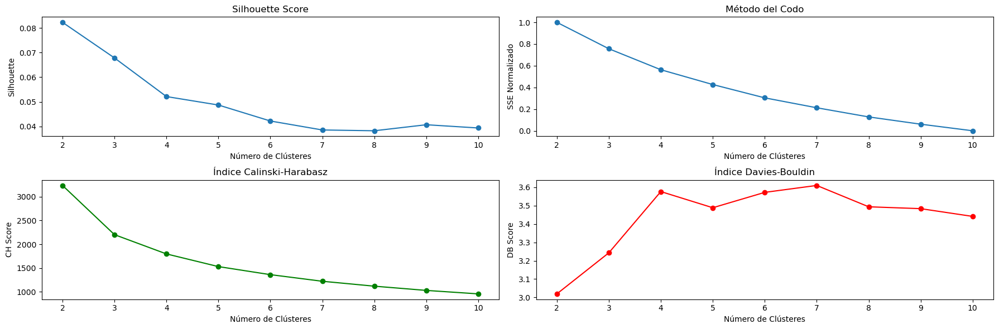

In [6]:
# Determinar número óptimo de clústeres
n_clusters = optimal_clusters(data)

## 📌 Clustering

In [9]:
# Aplicar clustering
n_clusters = 3
clustering_results = apply_clustering(data, n_clusters=n_clusters, n_components=300)

📦 Datos recibidos: 30,000 muestras y 16,020 características
KMeans - Clústeres encontrados: 3
MiniBatchKMeans - Clústeres encontrados: 3



🔍 Variables seleccionadas: hadm_id, p1, anchor_age, dx_count, proc_count, drg_mortality, drg_severity
✅ Figura guardada: ./figuras/clusters_KMeans.png


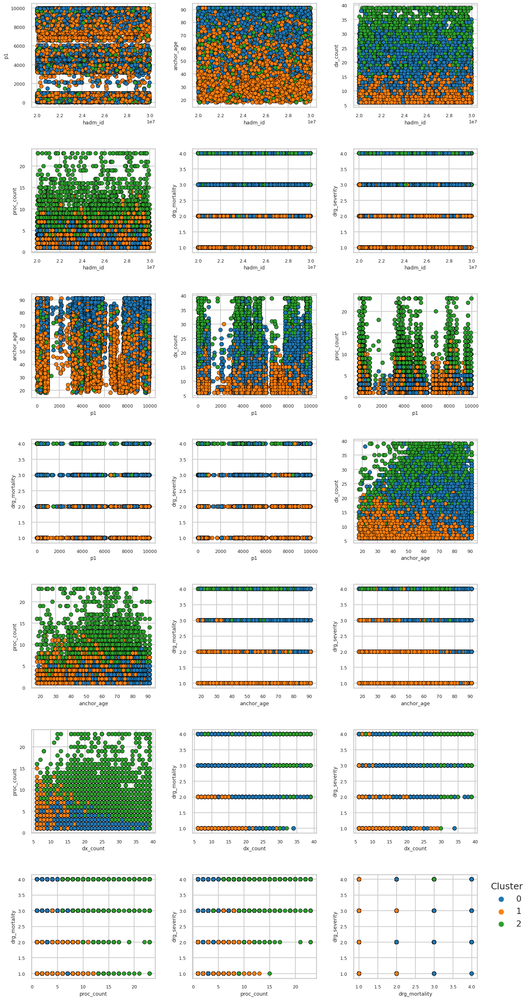

✅ Figura guardada: ./figuras/clusters_MiniBatchKMeans.png


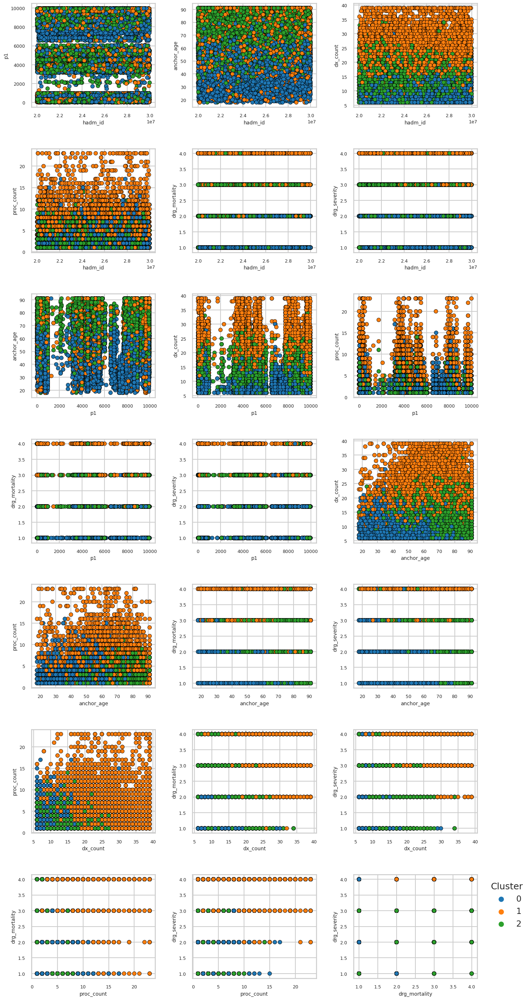

In [10]:
# Comparar clústeres en términos de variables originales
compare_clusters(df=df_sample,num_features=df_sample.shape[1], clustering_results=clustering_results)

## 📌 Selección de características

**Interpretation**
📊 **Información Mutua Normalizada (Normalized Mutual Information, NMI)**  
Mide la dependencia entre una característica y la variable objetivo. Cuanto mayor sea la MI, más relevante es la característica para la predicción. No asume relaciones lineales, lo que la hace útil incluso con relaciones no lineales.

| Valor de MI             | Interpretación                                                                       |
|-------------------------|----------------------------------------------------------------------------------------|
| Cercano a 0             | La característica aporta poca o ninguna información sobre la variable objetivo.       |
| Intermedio (0.1–0.5)    | La característica contiene algo de información relevante, posible utilidad moderada. |
| Alto (> 0.5)            | Alta dependencia con la variable objetivo → característica muy relevante.             |

In [11]:
# Selección de características y segunda fase de clustering
X_unweighted, X_weighted, feature_table, filtered_features = feature_selection(df_sample, clustering_results['KMeans'], continuous_vars, categorical_vars, threshold=0.2, return_names=True)

Características continuas: 7, características categóricas: 15
Total de características: 22

📊 Importancia de todas las variables (mutual information):
Variable             Score      % Relativo
----------------------------------------
drg_mortality        0.4400      10.57%
drg_severity         0.3435       8.25%
dx4                  0.3120       7.49%
dx2                  0.3109       7.47%
dx5                  0.3060       7.35%
dx3                  0.3053       7.33%
dx_count             0.2923       7.02%
dx6                  0.2893       6.95%
p1                   0.2209       5.30%
dx1                  0.2076       4.98%
description          0.2042       4.90%
proc_count           0.1970       4.73%
admit_provider_id    0.1476       3.54%
discharge_location   0.1388       3.33%
anchor_age           0.1161       2.79%
admission_location   0.1004       2.41%
admission_type       0.0748       1.80%
hadm_id              0.0666       1.60%
insurance            0.0534       1.28%
marit

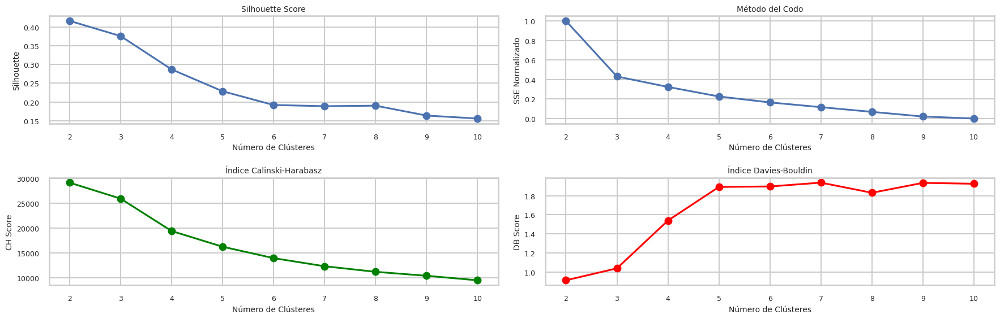

In [12]:
# Determinar número óptimo de clústeres
n_clusters_selected = optimal_clusters(X_weighted)

In [13]:
# Aplicar clustering
n_clusters_selected = 3
clustering_results_selected = apply_clustering(X_weighted, n_clusters_selected, n_components=X_weighted.shape[1])

📦 Datos recibidos: 30,000 muestras y 11 características
KMeans - Clústeres encontrados: 3
MiniBatchKMeans - Clústeres encontrados: 3



🔍 Variables seleccionadas: p1, dx5, dx4, dx6, dx3, dx2, dx1, description, dx_count, proc_count, drg_mortality, drg_severity
✅ Figura guardada: ./figuras/clusters_KMeans.png


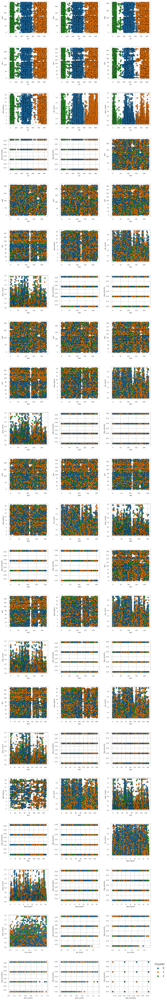

✅ Figura guardada: ./figuras/clusters_MiniBatchKMeans.png


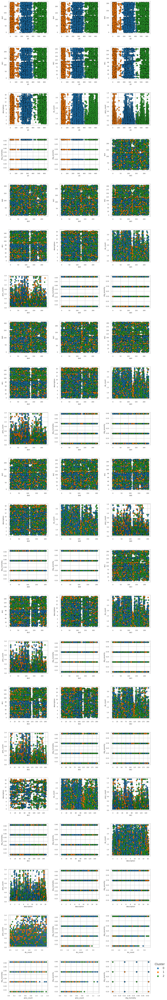

In [38]:
# Comparar clústeres en términos de variables originales
df_weighted = pd.DataFrame(X_weighted, columns=filtered_features)
compare_clusters(df=df_weighted,num_features=X_weighted.shape[1], clustering_results=clustering_results_selected)